![Astrofisica Computacional](../logo.PNG)

---
## 45. Ecuaciones Diferenciales Parciales II. Métodos de Diferencias Finitas. La Ecuación Lineal de Advección. 

Eduard Larrañaga (ealarranaga@unal.edu.co)

---


### Resumen

Se presentan algunos métodos para resolver la ecuación de advección lineal de advección.

`A. Garcia. Numerical Methods for Physics. (1999). Chapter 6 - 7 `

---

## La Ecuación Lineal de Advección 

Un ejemplo de los **sistemas hiperbólicos de primer orden** en una dimensión espacial es la **ecuación lineal de advección**, en la que la función $u=u(t,x)$ satisface

\begin{equation}
\partial_t u + v \partial_x u = 0\,\,,
\end{equation}

donde $v$ es una constante. Una solución exacta de esta ecuación está dada por cualquier función que dependa de los argumentos

\begin{equation}
u(t,x) = u(t=0,x-vt)\,\,.
\end{equation}

De esta forma, la ecuación de advección trasladará el perfil inicial dado a lo largo del eje-x con una velocidad constante $v$.

---

## Métodlos de Solución para la Ecuación de Advección

### 1. Discretización FTCS 

Este método de diferencias finitas esta basado en discretizar la derivada temporal hacia adelante y la derivada espacial centrada. Su nombre proviene de las siglas en inglés (**F**orward in **T**ime, **C**entered in **S**pace: FTCS).  Esta discretización lleva de inmediato a la relación 

\begin{equation}
  u^{(n+1)}_j = u^{(n)}_j - \frac{v \Delta t}{2\Delta x} \left(u^{(n)}_{j+1} - u^{(n)}_{j-1}\right)\,\,.
\end{equation}

En esta ecuación, el índice $n$ hace referencia a la discretización temporal mientras que el índice $j$ se refiere a la discretización espacial. 

**Condiciones de frontera**

Es importante notar que en este método, la definición de la malla necesita de un criterio para tratar las condiciones de frontera. Algunos de los posibles criterios son:

- *Outflow* : la información de los últimos puntos internos se copia en los puntos de frontera. En este caso el perfil sale del dominio de integración sin devolverse.

- *Condición Periodica* : La información de los puntos de la frontera en uno de los extremos se copia en el otro extremo. En esta caso, el perfil sale por uno de los extremos del dominio de integración para re-aparecer por el otro extremo.


**Estabilidad**

La estabilidad del método se analiza introduciendo la función $u(x,t^{n}) = u^{(n)} = e^{ikx}$ en la ecuación discretizada. Esto da como resultado

\begin{equation}
\begin{aligned}
u^{(n+1)}_j &= e^{ik j\Delta x } - \frac{v \Delta t}{2\Delta x} \left(e^{ik (j+1)\Delta x } - e^{ik (j-1) \Delta x }\right)\,\,,\\
&= \left[ 1 - \frac{v\Delta t}{2 \Delta x} \left( e^{ik\Delta x} - e^{-ik\Delta x} \right) \right] e^{ik j \Delta x }\,\,,\\
&= \underbrace{\left[ 1- \frac{v\Delta t}{\Delta x} i \sin(k\Delta x) \right]}_{{=\xi}} e^{ik\Delta x j}\,\,,
\end{aligned}
\end{equation}

donde el coeficiente $\xi$ satisface 

\begin{equation}
|\xi| = \sqrt{\xi \xi^*} = \sqrt{1 + \left(\frac{v\Delta t}{\Delta x} \sin(k\Delta x)\right)^2} > 1\,\,.
\end{equation}

Este resultado implica que el método FTCS es **incondicionalmente inestable** para la ecuación de advección!

### Ejemplo

La advección es un proceso importante en muchas areas de la astrofísica. Por ejemplo, algunos modelos de transporte en la heliosfera consideran distribuciones de partículas aceleradas por choques (Litvinenko-2014)que son descritas, en primera aproximación, por una ecuación de advección-difusión unidimensional para la densidad de partículas. En la aproximación de difusión débil, la ecuación que se debe resolver es

\begin{equation}
\frac{\partial u}{\partial t} + v\frac{\partial u}{\partial x} = 0\,\,,
\end{equation}

dodne $v$ representa la velocidad de advección constante que puede ser interpretada como la rapidez del viento solar.

Como un primer ejemplo para resolver esta ecuacion diferencial parcial, se advectará un perfil Gaussiano,

\begin{equation}
 \Psi_0 = \Psi(x,t=0) = e^{-\frac{(x-x_0)^2 }{(2 \sigma^2)}},
\end{equation}
 
donde $x_0 = 30$, $\sigma = \sqrt{15}$, con una velocidad positiva $v = 0.1$ en el dominio $[0,100]$.

En este caso se utilizará el criterio de **outflow** para las fronteras.

dt =  0.07000700070007
dx =  0.1001001001001001


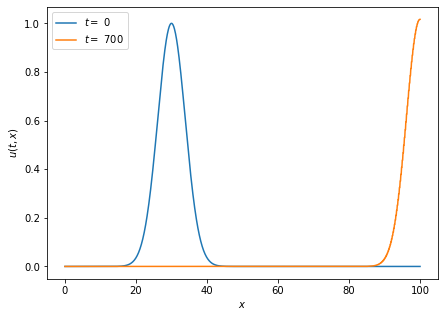

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

# Definition of the initial Gaussian profile
def Psi(x):
    x0 = 30. 
    sigma = np.sqrt(15.)
    return np.exp(-(x-x0)**2/(2*sigma**2))

# Definition of the grids
x_i = 0.
x_f = 100.
xgrid = np.linspace(x_i, x_f, 1000)
dx = xgrid[1] - xgrid[0]

t_i = 0.
t_f = 700.
tgrid = np.linspace(t_i, t_f, 10000)
dt = tgrid[1] - tgrid[0]


# Velocity of the advection
v = 0.1

# FTCS Method
def FTCS(u):
    unew = np.zeros(len(xgrid))
    for j in range(1,len(xgrid)-1):
        unew[j] = u[j] - ((v*dt)/(2*dx))*(u[j+1] - u[j-1])
                                                     
    # Boundary conditions
    unew[0] = unew[1]
    unew[len(unew)-1] = unew[len(unew)-2]
    
    return unew



# Time evolution to obtain the state of the profile at t_f                                               
u = Psi(xgrid)
for t in tgrid:
    u = FTCS(u)

                                                     
print('dt = ', dt)
print('dx = ', dx)
plt.figure(figsize=(7,5))
plt.plot(xgrid, Psi(xgrid), label=f'$t =$ {t_i:.0f}')
plt.plot(xgrid, u, label=f'$t =$ {t_f:.0f}')
plt.xlabel(r'$x$')
plt.ylabel(r'$u(t,x)$')
plt.legend()
plt.show()


---
## Evolución Temporal de la Solución

Es posible crear una pelicula animada que muestre la evolución temporal de la solución utilizando la libreria [matplotlib.pyplot.animation](https://matplotlib.org/stable/api/animation_api.html).


Primero, se modifica el algoritmo para que guarde la información de la evolución temporal en un arreglo.

dt =  0.1000100010001
dx =  0.1001001001001001


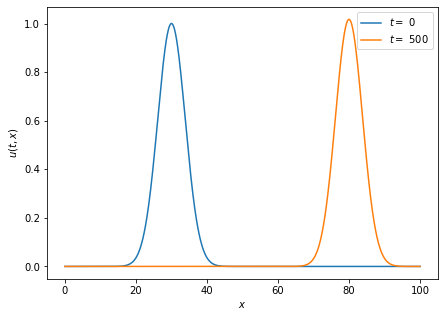

In [3]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

# Definition of the initial Gaussian profile
def Psi(x):
    x0 = 30. 
    sigma = np.sqrt(15.)
    return np.exp(-(x-x0)**2/(2*sigma**2))

# Definition of the grids
x_i = 0.
x_f = 100.
xgrid = np.linspace(x_i, x_f, 1000)
dx = xgrid[1] - xgrid[0]


t_i = 0.
t_f = 1000.
tgrid = np.linspace(t_i, t_f, 10000)
dt = tgrid[1] - tgrid[0]


# Velocity of the advection
v = 0.1

# FTCS Method
def FTCS(u):
    unew = np.zeros(len(xgrid))
    for j in range(1,len(xgrid)-1):
        unew[j] = u[j] - ((v*dt)/(2*dx))*(u[j+1] - u[j-1])
    unew[0] = unew[1]
    unew[len(unew)-1] = unew[len(unew)-2]
    return unew


u_data = np.zeros([len(tgrid), len(xgrid)])
u_data[0,:] = Psi(xgrid)


for i in range(1,len(tgrid)):
    b[i,:] = FTCS(u_data[i-1,:])



print('dt = ', dt)
print('dx = ', dx)
plt.figure(figsize=(7,5))
plt.plot(xgrid, u_data[0,:], label=f'$t =$ {tgrid[0]:.0f}')
plt.plot(xgrid, u_data[5000,:], label=f'$t =$ {tgrid[5000]:.0f}')
plt.xlabel(r'$x$')
plt.ylabel(r'$u(t,x)$')
plt.legend()
plt.show()


In [7]:
u_data

array([[ 9.35762297e-14,  1.14278973e-13,  1.39468782e-13, ...,
         2.95393998e-71,  1.85337457e-71,  1.16207624e-71],
       [ 1.11986411e-13,  1.11986411e-13,  1.36680375e-13, ...,
         3.09638772e-71,  1.94288711e-71,  1.94288711e-71],
       [ 1.10752824e-13,  1.10752824e-13,  1.33946750e-13, ...,
         3.24568044e-71,  2.00051023e-71,  2.00051023e-71],
       ...,
       [ 1.64871181e+02,  1.64871181e+02, -2.30287201e+03, ...,
         1.88155966e-04,  1.82295718e-04,  1.82295718e-04],
       [ 2.88147281e+02,  2.88147281e+02, -2.16762558e+03, ...,
         1.62924830e-04,  1.82588467e-04,  1.82588467e-04],
       [ 4.10825403e+02,  4.10825403e+02, -2.00958919e+03, ...,
         1.36353635e-04,  1.81606170e-04,  1.81606170e-04]])

In [8]:
import numpy as np
import matplotlib.pyplot as plt

from matplotlib import animation
from IPython.display import HTML
%matplotlib inline

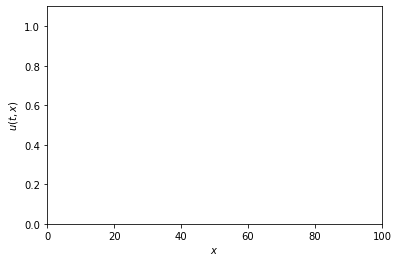

In [9]:
# Set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots()

ax.set_xlim(( 0, 100))
ax.set_ylim((0, 1.1))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$u(t,x)$')

line, = ax.plot([], [], lw=2)

In [10]:
# Define the initialization function, which plots the background of each frame
def init():
    line.set_data([], [])
    return (line,)

In [11]:
def animate(i):
    x = xgrid
    y = u_data[50*i,:] # We take only some of the frames (given by 50*i)
    line.set_data(x, y)
    return (line,)

In [12]:
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=20,  # only 200 frames with a duration of 20 ms each
                               blit=True)

In [13]:
HTML(anim.to_jshtml())


Como se mostró arriba, em método FTCS es **uincondicionalmente inestable** para la ecuación de advección. Por ello se produce el ma comportamiento en la parte final de la anterior animación.  


Para ilustrar nuevamente esta inestabilidad, consideraremos ahora la advección de un perfíl sinuosidal con un paso temporal $dt=0.02$ con condiciones de frontera periodicas. Nótese que en el intervalo temporal $[0, 350]$ el comportamiento no muestra inestabilidades, 

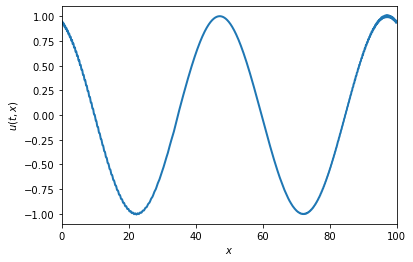

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML
%matplotlib inline

# Definition of the grids
x_i = 0.
x_f = 100.
xgrid = np.linspace(x_i, x_f, 1000)
dx = xgrid[1] - xgrid[0]

t_i = 0.
t_f = 350.
dt = 0.02
tgrid = np.arange(t_i, t_f, dt)

# Definition of the initial Sin profile
def Psi(x):
    return np.sin(4*np.pi*x/x_f)

# Velocity of the advection
v = 0.1

# FTCS Method
def FTCS(u):
    unew = np.zeros(len(xgrid))
    for j in range(1,len(xgrid)-1):
        unew[j] = u[j] - ((v*dt)/(2*dx))*(u[j+1] - u[j-1])
    # Periodic boundary conditions 
    unew[0] = unew[len(unew)-2]
    unew[len(unew)-1] = unew[1]
    return unew

u_data = np.zeros([len(tgrid), len(xgrid)])
u_data[0,:] = Psi(xgrid)


for i in range(1,len(tgrid)):
    u_data[i,:] = FTCS(u_data[i-1,:])


# Set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots()

ax.set_xlim(( 0, 100))
ax.set_ylim((-1.1, 1.1))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$u(t,x)$')

line, = ax.plot([], [], lw=2)

# Define the initialization function, which plots the background of each frame
def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    x = xgrid
    step = int(len(tgrid)/200)
    y = u_data[step*i,:] # We take only some of the frames (given by 50*i)
    line.set_data(x, y)
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=20,  # only 200 frames with a duration of 20 ms each
                               blit=True)

HTML(anim.to_jshtml())

Sin embargo, al extender el intervalo temporal a $[0,700]$, la inestabilidad aparece,

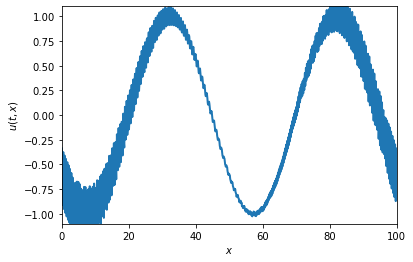

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML
%matplotlib inline

# Definition of the grids
x_i = 0.
x_f = 100.
xgrid = np.linspace(x_i, x_f, 1000)
dx = xgrid[1] - xgrid[0]

t_i = 0.
t_f = 700.
dt = 0.02
tgrid = np.arange(t_i, t_f, dt)

# Definition of the initial Sin profile
def Psi(x):
    return np.sin(4*np.pi*x/x_f)

# Velocity of the advection
v = 0.1

# FTCS Method
def FTCS(u):
    unew = np.zeros(len(xgrid))
    for j in range(1,len(xgrid)-1):
        unew[j] = u[j] - ((v*dt)/(2*dx))*(u[j+1] - u[j-1])
    # Periodic boundary conditions 
    unew[0] = unew[len(unew)-2]
    unew[len(unew)-1] = unew[1]
    return unew

u_data = np.zeros([len(tgrid), len(xgrid)])
u_data[0,:] = Psi(xgrid)


for i in range(1,len(tgrid)):
    u_data[i,:] = FTCS(u_data[i-1,:])


# Set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots()

ax.set_xlim(( 0, 100))
ax.set_ylim((-1.1, 1.1))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$u(t,x)$')

line, = ax.plot([], [], lw=2)

# Define the initialization function, which plots the background of each frame
def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    x = xgrid
    step = int(len(tgrid)/200)
    y = u_data[step*i,:] # We take only some of the frames (given by 50*i)
    line.set_data(x, y)
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=20,  # only 200 frames with a duration of 20 ms each
                               blit=True)

HTML(anim.to_jshtml())

In [ ]:
HTML(anim.to_html5_video())

---

###  2. Método Upwind 

En este método de solución se considera una discretización  de primer orden en el tiempo y de primer orden en el espacio. Para la derivada espacial se tiene dos posibilidades,

\begin{equation}
\begin{aligned}
\frac{\partial u}{\partial x} &\approx \frac{1}{\Delta x}(u_j - u_{j-1}) \hspace{1cm}\text{diferencias finitas hacia la derecha (upwind)}\\
\frac{\partial u}{\partial x} &\approx \frac{1}{\Delta x}(u_{j+1} - u_{j})
\hspace{1cm}\text{diferencias finitas hacia la izquierda (downwind)}
\end{aligned}
\end{equation}

Las dos posibilidades se denominand aproximaciones laterales porque usan información de un lado o del otro del punto $x_j$. Incorporando estas discretizaciones en la ecuación de advección da como resultado

\begin{equation}
\begin{aligned}
u_j^{(n+1)} &= u_j^{(n)} - \frac{v\Delta t}{\Delta x} \left(u_j^{(n)} - u_{j-1}^{(n)}\right) \hspace{1cm}\text{(upwind)}\\
u_j^{(n+1)} &= u_j^{(n)} - \frac{v\Delta t}{\Delta x} \left(u_{j+1}^{(n)} - u_{j}^{(n)}\right) \hspace{1cm}\text{(downwind)}\,\,.
\end{aligned}
\end{equation}


**Estabilidad**

Un análisis de estabilidad muestra que el método upwind es estable si

\begin{equation}
0 \le \frac{v \Delta t}{\Delta x} \le 1\,\,,
\end{equation}

mientras que el método downwindes estable si

\begin{equation}
-1 \le \frac{v \Delta t}{\Delta x} \le 0\,\,,
\end{equation}

lo cual confirma que para $v > 0$ se debe utilizar el upwind mientras que para $v < 0$ se debe utilizar el downwind.

La condición

\begin{equation}
\alpha = \left|\frac{v\Delta t}{\Delta x}\right| \le 1\,\,
\end{equation}

es una realización matemática de el principio de causalidad: *la propagación de la información (via advección) en un paso de tiempo $\Delta t$ no debe "saltar" adelante más alla del tamaño $\Delta x$ de un intervalo de la malla espacial*.

El criterio $\alpha \le 1$ usualmente se denomina la **condición de Courant-Friedrics-Lewy (CFL)** y se utiliza para determinar el paso temporal permitido dado el tamaño de la malla espacial $\Delta x$. Así, se suele utilizar el paso temporal

\begin{equation}
\Delta t = c_\mathrm{CFL} \frac{\Delta x}{|v|}\,\,,
\end{equation}

donde $c_\mathrm{CFL} \le 1$ se denomina el factor CFL.

---
### 3. Método Lax-Friedrich

El método Lax-Friedrichs, al igual que el FTCS, es de primer orden en el tiempo y segundo orden en el espacio. La ecuación correspondiente es

\begin{equation}
u_{j}^{(n+1)} = \frac{1}{2}\left(u^{(n)}_{j+1} + u^{(n)}_{j-1}\right) - 
\frac{v \Delta t}{2\Delta x} \left(u^{(n)}_{j+1} - u^{(n)}_{j-1}\right)\,\,,
\end{equation}

de donde se puede comprobar que este método difiere del método FTCS en que se ha logrado la estabilidad para $\alpha \le 1$ al utilizar el promedio del antiguo valor (i.e. en $n$) en los puntos $j+1$ y $j-1$ para calcular el valor actualizado (i.e, en $n+1$) en el punto $j$. Es posible demostrar que este tratamiento es equivalente a incluir un termino disipativo en las ecuaciones (que se encarga de amortiguar la inestabilidad del método FTCS) y por ello conelleva a una menor precisión que se manifiesta como una disipación del perfil inicial.

dx = 0.1001001001001001
C_{CFL} = 0.2
dt = 0.2002002002002002


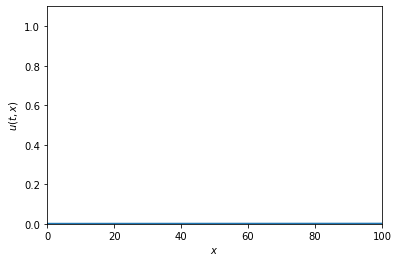

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML
%matplotlib inline

# Definition of the initial Gaussian profile
def Psi(x):
    x0 = 30. 
    sigma = np.sqrt(15.)
    return np.exp(-(x-x0)**2/(2*sigma**2))

# Velocity of the advection
v = 0.1

# CFL Coefficient
C = 0.2

# Definition of the grids
x_i = 0.
x_f = 100.
xgrid = np.linspace(x_i, x_f, 1000)
dx = xgrid[1] - xgrid[0]

t_i = 0.
t_f = 900.
dt = C*dx/v
tgrid = np.arange(t_i, t_f, dt)

print('dx =', dx)
print('C_{CFL} =', C)
print('dt =', dt)

# Upwind Method
def upwind(u):
    unew = np.zeros(len(xgrid))
    # Left boundary condition
    unew[0] = u[0]
    for j in range(1,len(xgrid)):
        unew[j] = u[j] - ((v*dt)/(dx))*(u[j] - u[j-1])
    return unew

u_data = np.zeros([len(tgrid), len(xgrid)])
u_data[0,:] = Psi(xgrid)


for i in range(1,len(tgrid)):
    u_data[i,:] = upwind(u_data[i-1,:])


# Set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots()

ax.set_xlim(( 0, 100))
ax.set_ylim((0, 1.1))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$u(t,x)$')

line, = ax.plot([], [], lw=2)

# Define the initialization function, which plots the background of each frame
def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    x = xgrid
    step = int(len(tgrid)/200)
    y = u_data[step*i,:] # We take only some of the frames (given by 50*i)
    line.set_data(x, y)
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=20,  # only 200 frames with a duration of 20 each
                               blit=True)

HTML(anim.to_jshtml())

--- 
### 4. Método Leap-Frog 

El método **Leap Frog (LF)** (también llamado método del punto medio) es de segundo orden tanto en el tiempo como en el espacio. Éste viene dado por la ecuación

\begin{equation}
u_j^{(n+1)} = u_j^{(n-1)} - \frac{v \Delta t}{\Delta
x} \left(u^{(n)}_{j+1} - u^{(n)}_{j-1}\right)\,\,.
\end{equation}

Es posible demostrar que este método es estable para $\alpha < 1$ y se caracteriza porque **no es disipativo**. Esto significa que el perfil inicial se traslada sin cambiar pero un estudio detallado muestra que los modos que componen el perfil no se desplazan con la misma velocidad, lo cual puede llevar a oscilaciones de alta frecuencia  que no se amortiguan (no se inclute una "viscosidad numérica").

dx = 0.1001001001001001
C_{CFL} = 1.0
dt = 1.001001001001001


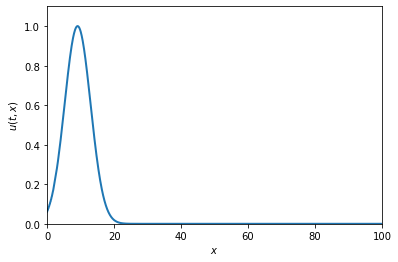

In [22]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML
%matplotlib inline

# Definition of the initial Gaussian profile
def Psi(x):
    x0 = 30. 
    sigma = np.sqrt(15.)
    return np.exp(-(x-x0)**2/(2*sigma**2))

# Velocity of the advection
v = 0.1

# CFL Coefficient
C = 1.

# Definition of the grids
x_i = 0.
x_f = 100.
xgrid = np.linspace(x_i, x_f, 1000)
dx = xgrid[1] - xgrid[0]

t_i = 0.
t_f = 2000.
dt = C*dx/v
tgrid = np.arange(t_i, t_f, dt)

print('dx =', dx)
print('C_{CFL} =', C)
print('dt =', dt)

# FTCS Method
def FTCS(u):
    unew = np.zeros(len(xgrid))
    for j in range(1,len(xgrid)-1):
        unew[j] = u[j] - ((v*dt)/(2*dx))*(u[j+1] - u[j-1])
    # Periodic boundary conditions 
    unew[0] = unew[len(unew)-2]
    unew[len(unew)-1] = unew[1]
    return unew


# Leap Frog Method
def LF(u0, u1):
    unew = np.zeros(len(xgrid))
    # Left boundary condition
    unew[0] = u0[0] - ((v*dt)/(dx))*(u1[1] - u1[0])
    # Right boundary condition
    unew[-1] = u0[-1] - ((v*dt)/(dx))*(u1[-1] - u1[-2])
    
    for j in range(1,len(xgrid)-1):
        unew[j] = u0[j] - ((v*dt)/(dx))*(u1[j+1] - u1[j-1])
    return unew

u_data = np.zeros([len(tgrid), len(xgrid)])
u_data[0,:] = Psi(xgrid)
u_data[1,:] = FTCS(Psi(xgrid))


for i in range(2,len(tgrid)):
    u_data[i,:] = LF(u_data[i-2,:],u_data[i-1,:])


# Set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots()

ax.set_xlim(( 0, 100))
ax.set_ylim((0, 1.1))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$u(t,x)$')

line, = ax.plot([], [], lw=2)

# Define the initialization function, which plots the background of each frame
def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    x = xgrid
    step = int(len(tgrid)/200)
    y = u_data[step*i,:] # We take only some of the frames (given by 50*i)
    line.set_data(x, y)
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=20,  # only 200 frames with a duration of 20 each
                               blit=True)

HTML(anim.to_jshtml())

---

### 5.Método Lax-Wendroff 

El método **Lax-Wendroff** es una extensión de método Lax-Friedrich haciendolo de segundo orden en el tiempo y en el espacio. La ecuación que lo define es

\begin{equation}
u_j^{(n+1)} = u_j^n - \frac{v\Delta t}{2\Delta x} \left(u_{j+1}^{(n)}
- u_{j-1}^{(n)} \right) + \frac{v^2(\Delta t)^2}{2(\Delta x)^2} \left(
u_{j-1}^{(n)} - 2 u_j^{(n)} + u_{j+1}^{(n)}\right)\,\,.
\end{equation}

Este método posee una mejor precisión que el método Lax-Friedrich y es estable para $\alpha \le 1$.

dx = 0.1001001001001001
C_{CFL} = 0.2
dt = 0.2002002002002002


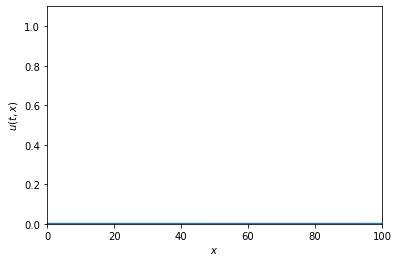

In [23]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML
%matplotlib inline

# Definition of the initial Gaussian profile
def Psi(x):
    x0 = 30. 
    sigma = np.sqrt(15.)
    return np.exp(-(x-x0)**2/(2*sigma**2))

# Velocity of the advection
v = 0.1

# CFL Coefficient
C = 0.2

# Definition of the grids
x_i = 0.
x_f = 100.
xgrid = np.linspace(x_i, x_f, 1000)
dx = xgrid[1] - xgrid[0]

t_i = 0.
t_f = 900.
dt = C*dx/v
tgrid = np.arange(t_i, t_f, dt)

print('dx =', dx)
print('C_{CFL} =', C)
print('dt =', dt)

# Lax-Wendroff Method
def LW(u):
    unew = np.zeros(len(xgrid))
    # Left boundary condition
    unew[0] = u[0] - ((v*dt)/(2*dx))*(u[1] - u[0])\
             + ((v**2 *dt**2)/(2*dx**2))*(u[0] - 2*u[0] + u[1])
    # Right boundary condition
    unew[-1] = u[-1] - ((v*dt)/(2*dx))*(u[-1] - u[-2])\
                  + ((v**2 *dt**2)/(2*dx**2))*(u[-2] - 2*u[-1] + u[-1])
    
    for j in range(1,len(xgrid)-1):
        unew[j] = u[j] - ((v*dt)/(2*dx))*(u[j+1] - u[j-1])\
                  + ((v**2 *dt**2)/(2*dx**2))*(u[j-1] - 2*u[j] + u[j+1])
    return unew

u_data = np.zeros([len(tgrid), len(xgrid)])
u_data[0,:] = Psi(xgrid)


for i in range(1,len(tgrid)):
    u_data[i,:] = LW(u_data[i-1,:])


# Set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots()

ax.set_xlim(( 0, 100))
ax.set_ylim((0, 1.1))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$u(t,x)$')

line, = ax.plot([], [], lw=2)

# Define the initialization function, which plots the background of each frame
def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    x = xgrid
    step = int(len(tgrid)/200)
    y = u_data[step*i,:] # We take only some of the frames (given by 50*i)
    line.set_data(x, y)
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=20,  # only 200 frames with a duration of 20 each
                               blit=True)

HTML(anim.to_jshtml())

dx = 0.1001001001001001
C_{CFL} = 0.2
dt = 0.2002002002002002


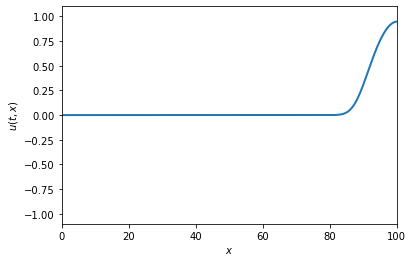

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML
%matplotlib inline

# Definition of the initial Sin profile
def Psi(x):
    return np.sin(4*np.pi*x/x_f)

# Velocity of the advection
v = 0.1

# CFL Coefficient
C = 0.2

# Definition of the grids
x_i = 0.
x_f = 100.
xgrid = np.linspace(x_i, x_f, 1000)
dx = xgrid[1] - xgrid[0]

t_i = 0.
t_f = 900.
dt = C*dx/v
tgrid = np.arange(t_i, t_f, dt)

print('dx =', dx)
print('C_{CFL} =', C)
print('dt =', dt)

# Lax-Wendroff Method
def LW(u):
    unew = np.zeros(len(xgrid))
    
    # Periodic boundary conditions 
    unew[0] = u[len(unew)-1]
    
    for j in range(1,len(xgrid)):
        unew[j] = u[j] - ((v*dt)/(dx))*(u[j] - u[j-1])
    return unew

u_data = np.zeros([len(tgrid), len(xgrid)])
u_data[0,:] = upwind(Psi(xgrid))


for i in range(1,len(tgrid)):
    u_data[i,:] = upwind(u_data[i-1,:])


# Set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots()

ax.set_xlim(( 0, 100))
ax.set_ylim((-1.1, 1.1))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$u(t,x)$')

line, = ax.plot([], [], lw=2)

# Define the initialization function, which plots the background of each frame
def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    x = xgrid
    step = int(len(tgrid)/200)
    y = u_data[step*i,:] # We take only some of the frames (given by 50*i)
    line.set_data(x, y)
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=20,  # only 200 frames with a duration of 20 each
                               blit=True)

HTML(anim.to_jshtml())

